# Plotting COLMAP Data and Camera Poses 

In [1]:
# Demo test scene: Gerrard Hall 
# Image data provided by COLMAP 
# Colmap generated: images, 3D points, cameras

import open3d as o3d
import numpy as np
import plotly.graph_objects as go 
from scipy.spatial.transform import Rotation as R
from colmapParsingUtils import *

from mpl_toolkits.mplot3d import axes3d
from matplotlib import cm
import matplotlib.pyplot as plt

import tensorflow as tf
import cv2

%load_ext autoreload
%autoreload 2
%autosave 180

# Limit GPU memory, if running notebook on GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
print(gpus)
if gpus:
    try:
        memlim = 2*1024
        tf.config.experimental.set_virtual_device_configuration(gpus[0], [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=memlim)])
    except RuntimeError as e:
        print(e)

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


2024-08-14 12:57:54.634553: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-14 12:57:54.658538: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-14 12:57:54.658557: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-14 12:57:54.659499: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-14 12:57:54.664155: I tensorflow/core/platform/cpu_feature_gua

Autosaving every 180 seconds
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2024-08-14 12:57:55.654359: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-14 12:57:55.680610: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-14 12:57:55.680734: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [32]:
# Load pose estimations from COLMAP 

images_colmap = read_images_text('/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/images.txt')
cameras = read_cameras_text('/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/cameras.txt')
pts3d = read_points3D_text('/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/points3D.txt')

# print(images[1])
# print(cameras[1])
# print(pts3d[1])

<class 'dict'>
[Point3D(id=50550, xyz=array([-0.80275081,  0.20678899,  0.45578969]), rgb=array([135, 108,  81]), error=1.1460145273910631, image_ids=array([24, 25, 27, 28]), point2D_idxs=array([ 7160,  8258,  8817, 10120])), Point3D(id=50503, xyz=array([-0.31040434, -0.71646258, -0.95114044]), rgb=array([119, 119, 118]), error=1.5099629074478267, image_ids=array([24, 25, 27, 37, 35, 42, 45, 41, 43, 38, 39, 36, 33, 44, 47, 50]), point2D_idxs=array([5678, 7967, 7391, 6802, 5862, 6648, 7464, 7245, 6899, 5026, 9176,
       7151, 9684, 7969, 7752, 7643])), Point3D(id=50327, xyz=array([-0.39968495, -0.50856517, -0.7076791 ]), rgb=array([58, 49, 45]), error=0.5460845656217623, image_ids=array([24, 25, 28, 30, 31]), point2D_idxs=array([ 5809,  6935,  8143,  9190, 10783])), Point3D(id=50302, xyz=array([-1.11031804, -0.87912557,  1.60731863]), rgb=array([138, 111, 101]), error=0.4292874561677236, image_ids=array([24, 26, 25]), point2D_idxs=array([6933, 6504, 6497])), Point3D(id=50209, xyz=array

In [38]:
# # Import point data from read file
# # DID NOT WORK, COME BACK TO THIS
# ptdata = []
# ptdata = [point['xyz'] for point in pts3d.values()]


# print(ptdata[0])    


# # for i in range(len(pts3d)):
# #     ptsxyz = pts3d.
# #     ptdata[i] = ptsxyz

In [39]:
# Extract 3d points from raw file 

pointdata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/points3D.txt"
num_pts = 75497 # Gerrard Hall

# points_data = []
scene_pts = np.zeros([num_pts, 3]) 
idx = 0

with open(pointdata_fn, 'r') as file:
    lines = file.readlines()[3:]  # Skip the first three lines
    
    for line in lines:
        elements = line.strip().split()
        
        row = [float(elem) for elem in list(elements)]

        scene_pts[idx,0] = row[1]
        scene_pts[idx,1] = row[2]
        scene_pts[idx,2] = row[3]
        idx += 1

# Filter RGB data into separate numpy array 
rgb_data = np.zeros([num_pts, 3])
idx = 0

with open(pointdata_fn, 'r') as file:
    lines = file.readlines()[3:] # Skip the first three lines 
    for line in lines:
        elements = line.strip().split()
        row = [float(elem) for elem in list(elements)]

        rgb_data[idx,0] = row[4]
        rgb_data[idx,1] = row[5]
        rgb_data[idx,2] = row[6]
        idx += 1

# SCALE COLORS
rgb_data = rgb_data/255
# print(scene_pts[:10])

[[-0.80275081  0.20678899  0.45578969]
 [-0.31040434 -0.71646258 -0.95114044]
 [-0.39968495 -0.50856517 -0.7076791 ]
 [-1.11031804 -0.87912557  1.60731863]
 [-0.19165158 -0.72593764 -1.32392866]
 [-0.19066057 -0.83021178 -1.31061558]
 [-0.90589804 -0.65009611  0.76851325]
 [-1.0531165  -0.91818088  1.14299459]
 [-1.19949362 -0.77076966  1.96180059]
 [-1.33980063 -0.94976392  1.49193597]]


In [4]:
#convert COLMAP poses (xyz,quats) to rotm

poses = np.zeros([len(images_colmap),4,4])
images = np.zeros([len(poses),250,250,3])
# ****????
# images = np.zeros([len(poses),1000,1000,3]) #full resolution


skip_indices = {56, 58}  # Use a set to store the indices to skip

#loop through <images_from_colmap> to get 3D poses of cameras at each timestamp
# print(len(images_from_colmap))
for n in range(len(images_colmap)):
    if n in skip_indices:
        continue

    trans31 = images_colmap[n+1].tvec[:,None]
    # ****????

    # from colmap2nerf import qvec2rotmat
    # ****????

    # Pull quaternion and translation vector
    qvec = images_colmap[n+1].qvec #raw
    tvec = images_colmap[n+1].tvec[:,None]
    # print(tvec)
    # ****????
    
    t = tvec.reshape([3,1])
    # print(tvec)
    R = qvec2rotmat(-qvec)
    # ****????
    
    bottom = np.array([0.0, 0.0, 0.0, 1.0]).reshape([1, 4])
    m = np.concatenate([np.concatenate([R, t], 1), bottom], 0)
    c2w = np.linalg.inv(m)
    
    c2w[0:3,2] *= -1 # flip the y and z axis
    c2w[0:3,1] *= -1
    c2w = c2w[[1,0,2,3],:]
    c2w[2,:] *= -1 # flip whole world upside down
    # ****????


    poses[n] = c2w
    
    #~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

    #line up z with origin
    poses[n,2,-1] += 16 #desk
    # poses[n,2,-1] += 10 #bike
    # ****????

    #downscale images
    #sync order of images with order of poses
    # temp = cv2.imread("desk_images/"+images_colmap[n+1].name)/255    
    # temp = cv2.resize(temp, dsize=(250,250), interpolation=cv2.INTER_CUBIC)
#     temp = cv2.resize(temp, dsize=(100,100), interpolation=cv2.INTER_LINEAR)
#     temp = cv2.resize(temp, dsize=(252,189), interpolation=cv2.INTER_LINEAR)#se f
    # images[n,:,:,0] = temp[:,:,2]
    # images[n,:,:,1] = temp[:,:,1]
    # images[n,:,:,2] = temp[:,:,0]
    # ****????

#GET REST OF PARAMS NEEDED FOR tinyNeRF format~~~~~~~~~~~~~~~~~~~~~~~~~~~~    

#fix order of colors
images[:,:,:,0], images[:,:,:,1] = images[:,:,:,1], images[:,:,:,0]

H,W = images.shape[1:3]
# print(H,W)
testimg, testpose = images[55], poses[55]

focal = cameras[1].params[0] #test- see if same focal length can be shared across all images
# focal = np.array(984.411).astype(np.double) #old
# focal = np.array(98.4411).astype(np.double) # IMPORTANT --> LOOKS LIKE THIS NEEDS TO BE SCALED WHEN IMAGES ARE DOWNSAMPLED!
# focal = int(focal/30)
focal = focal/12
print(focal)
# print(poses)
#~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

318.8074217375768


98


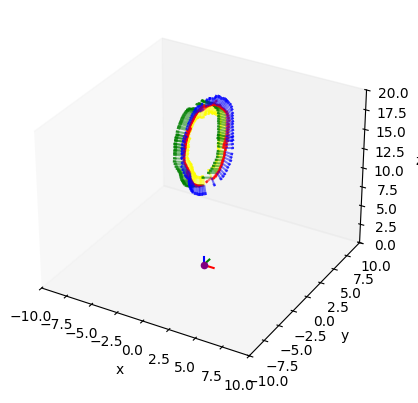

In [24]:
#debug coordinate system in <poses>

# #scale poses to unit cube
# radii = np.sqrt(np.sum(poses[:,:3,-1]**2, axis = 1))
# print(max(radii))
# poses[:,:3,-1] = 3*poses[:,:3,-1]/max(radii)


# camera_centers = ax.scatter3D(poses[:,0,-1],poses[:,1,-1],poses[:,2,-1])
headings = poses[:,:3,:3] @ np.array([0,0,-1]) #works
# print(headings)

# print(poses[0])
ax = plt.figure().add_subplot(projection='3d')
ax.set_xlim([-10,10])
ax.set_ylim([-10,10])
ax.set_zlim([0,20])
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.grid(False)
X, Y, Z = axes3d.get_test_data(0.05)
# ax.contour(X, Y, Z, cmap=cm.coolwarm)  # Plot contour curves

#plot axis
ax.scatter3D(0,0,0, color='purple')
ax.plot([0,1],[0,0],[0,0], color = 'red')
ax.plot([0,0],[0,1],[0,0], color = 'green')
ax.plot([0,0],[0,0],[0,1], color = 'blue')

ax.quiver(poses[:,0,-1],poses[:,1,-1],poses[:,2,-1], headings[:,0], headings[:,1], headings[:,2], color = 'yellow', alpha = 0.5)
headings = poses[:,:3,:3] @ np.array([1,0,0])
ax.quiver(poses[:,0,-1],poses[:,1,-1],poses[:,2,-1], headings[:,0], headings[:,1], headings[:,2], color = 'red', alpha = 0.5)
headings = poses[:,:3,:3] @ np.array([0,1,0])
ax.quiver(poses[:,0,-1],poses[:,1,-1],poses[:,2,-1], headings[:,0], headings[:,1], headings[:,2], color = 'green', alpha = 0.5)
headings = poses[:,:3,:3] @ np.array([0,0,1]) 
ax.quiver(poses[:,0,-1],poses[:,1,-1],poses[:,2,-1], headings[:,0], headings[:,1], headings[:,2], color = 'blue', alpha = 0.5)
print(len(poses))
plt.show()



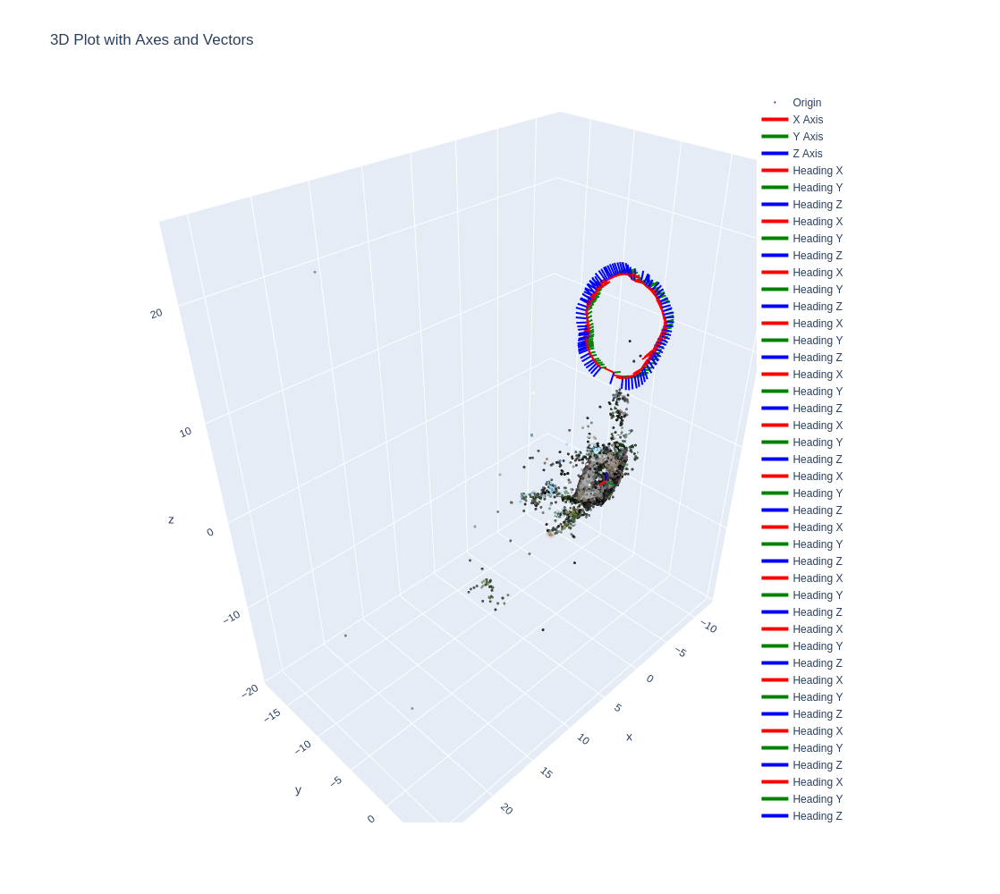

In [44]:
fig = go.Figure()

# Create a marker for the origin
fig.add_trace(go.Scatter3d(
    x=[0], y=[0], z=[0],
    mode='markers',
    marker=dict(size=1, color='purple'),
    name='Origin'
))

# Plot coordinate axes x
fig.add_trace(go.Scatter3d(
    x=[0, 1], y=[0, 0], z=[0, 0],
    mode='lines',
    line=dict(color='red', width=4),
    name='X Axis'
))
# Plot coordinate axes y
fig.add_trace(go.Scatter3d(
    x=[0, 0], y=[0, 1], z=[0, 0],
    mode='lines',
    line=dict(color='green', width=4),
    name='Y Axis'
))
# Plot coordinate axes z
fig.add_trace(go.Scatter3d(
    x=[0, 0], y=[0, 0], z=[0, 1],
    mode='lines',
    line=dict(color='blue', width=4),
    name='Z Axis'
))

# Compute and plot quivers for each pose
arrow_length = 1.0  # Length of the arrow lines
colors = ['red', 'green', 'blue']
for pose in poses:
    position = pose[:, -1]
    rotation_matrix = pose[:, :3]
    
    # Calculate heading vectors
    headings = np.array([
        rotation_matrix @ np.array([1, 0, 0]),
        rotation_matrix @ np.array([0, 1, 0]),
        rotation_matrix @ np.array([0, 0, 1])
    ])
    
    # Add arrows
    for i, (heading, color) in enumerate(zip(headings, colors)):
        fig.add_trace(go.Scatter3d(
            x=[position[0], position[0] + heading[0] * arrow_length],
            y=[position[1], position[1] + heading[1] * arrow_length],
            z=[position[2], position[2] + heading[2] * arrow_length],
            mode='lines+markers',
            line=dict(color=color, width=4),
            marker=dict(size=.1, color=color),
            name=f'Heading {chr(88+i)}'
        ))

# ADD 3D Points to the figure 
fig.add_trace(go.Scatter3d(
    x=scene_pts[:,0],
    y=scene_pts[:,1],
    z=scene_pts[:,2],
    mode='markers',
    marker=dict(
        size=1,  # Marker size
        color=rgb_data,  # Marker color
        opacity=0.8  # Marker opacity
    )
))


# Update layout for better visualization
fig.update_layout(
    scene=dict(
        # xaxis=dict(range=[-10, 10], title='x'),
        # yaxis=dict(range=[-10, 10], title='y'),
        # zaxis=dict(range=[0, 20], title='z'),
    ),
    title='3D Plot with Axes and Vectors',
    legend=dict(x=0.8, y=0.5), 
    width = 1000,
    height = 1000
)

# Show the plot
fig.show()